In [185]:
from tensorflow_addons import image as tfa_image
import numpy as np

import tensorflow as tf

from single_view_mpi.libs import mpi
from single_view_mpi.libs import nets
# from libs import mpi
# from libs import nets
input = tf.keras.Input(shape=(None, None, 3))
output = nets.mpi_from_image(input)

model = tf.keras.Model(inputs=input, outputs=output)
print('Model created.')
# Our full model, trained on RealEstate10K.
model.load_weights('single_view_mpi/single_view_mpi_full_keras/single_view_mpi_keras_weights')
print('Weights loaded.')

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20, 10)

# Input image
inputfile = 'single_view_mpi/sofa.png'

Model created.
Weights loaded.


In [186]:
# im = Image.open(inputfile)
# im2 = im.resize((512,512))
# im2.save(inputfile)

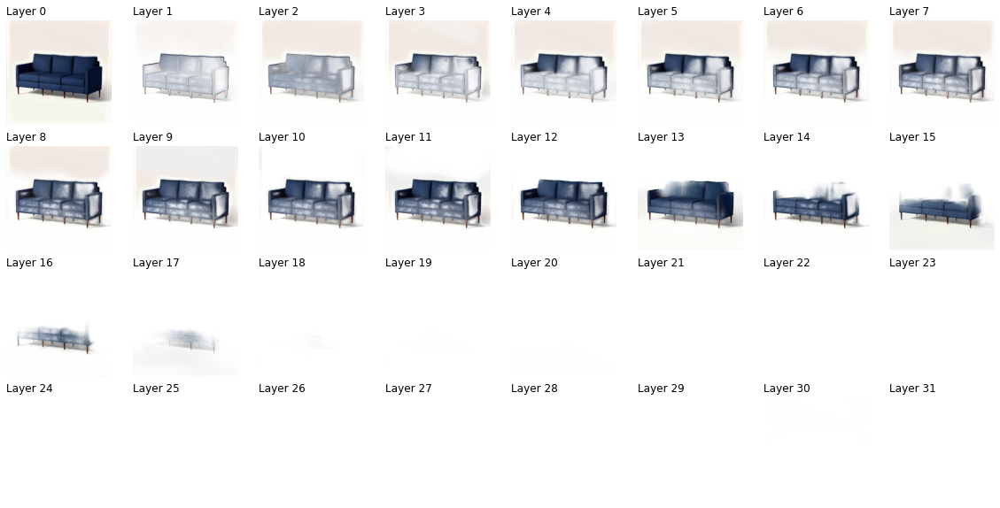

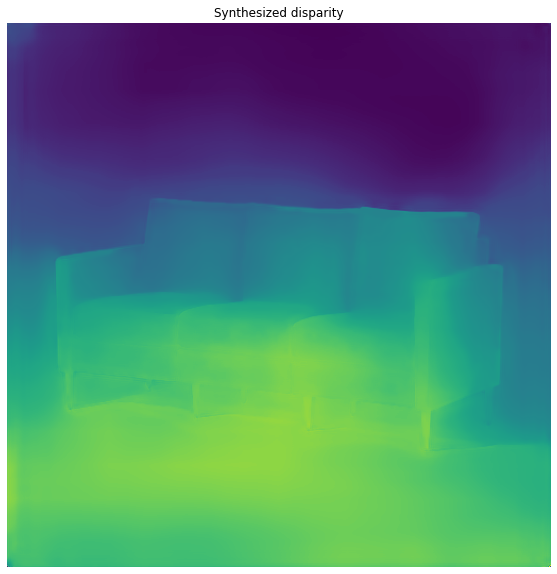

In [187]:
input_rgb = tf.image.decode_image(tf.io.read_file(inputfile), dtype=tf.float32)

# Generate MPI
layers = model(input_rgb[tf.newaxis])[0]
depths = mpi.make_depths(1.0, 100.0, 32).numpy()

# Layers is now a tensor of shape [L, H, W, 4].
# This represents an MPI with L layers, each of height H and width W, and
# each with an RGB+Alpha 4-channel image.

# Depths is a tensor of shape [L] which gives the depths of the L layers.

# Display layer images
for i in range(32):
  plt.subplot(4, 8, i+1)
  plt.imshow(layers[i])
  plt.axis('off')
  plt.title('Layer %d' % i, loc='left')
plt.show()

# Display computed disparity
disparity = mpi.disparity_from_layers(layers, depths)
plt.imshow(disparity[..., 0])
plt.axis('off')
plt.title('Synthesized disparity')
plt.show()

# Generating views from nearby positions

In [176]:
with open('../training_models/imagenet_classes.txt') as f:
    classes = [line.strip() for line in f.readlines()]

imagenet_model = models.resnet18(pretrained=True)
imagenet_model.eval();

def predict_from_rendered(rendered, show = True, return_val = False):
    rendered_img = Image.fromarray((np.array(rendered)*255).astype('uint8'))

    img_t = transform(rendered_img)
    batch_t = torch.unsqueeze(img_t, 0)
    out = imagenet_model(batch_t)

    _, indices = torch.sort(out, descending=True)
    percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
    pred_idx = indices[0][:1].item()
    title = "Class:%s, Confidence:%0.02f"%(classes[pred_idx], percentage[pred_idx].item()/100)

    if show:
        plt.imshow(rendered_img)
        plt.title(title)
        plt.axis('off')
        plt.show()
    if return_val:
        return pred_idx, percentage[pred_idx]

In [179]:
import torch
import torchvision
from torchvision import models
from PIL import Image
import pyheif
import os
import matplotlib.pyplot as plt

from torchvision import transforms

transform = transforms.Compose([            #[1]
 transforms.Resize(256),                    #[2]
 transforms.Resize(256),                    #[3]
 transforms.ToTensor(),                     #[4]
 transforms.Normalize(                      #[5]
 mean=[0.485, 0.456, 0.406],                #[6]
 std=[0.229, 0.224, 0.225]                  #[7]
 )])

In [181]:
xoffset

0.2

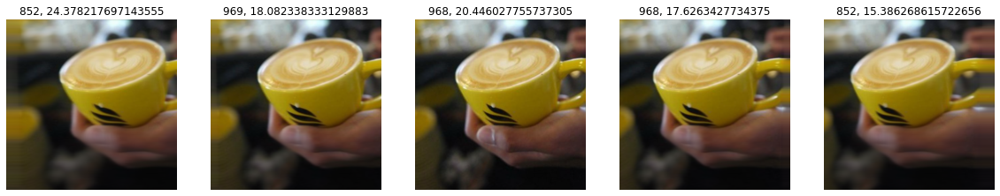

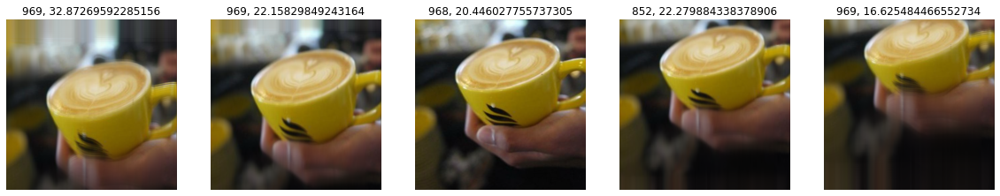

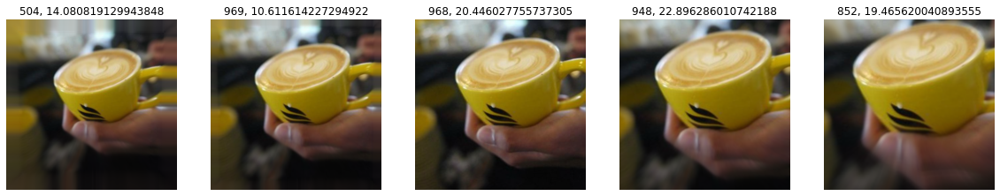

In [180]:
# The reference camera position can just be the identity
reference_pose = tf.constant(
    [[1.0, 0.0, 0.0, 0.0], [0.0, 1.0, 0.0, 0.0], [0.0, 0.0, 1.0, 0.0]])

# Accurate intrinsics are only important if we are trying to match a ground
# truth output. Here we just give intrinsics for a 16:9 image with the
# principal point in the center.
intrinsics = tf.constant([1.0, 1.0 * 16/9, 0.5, 0.5])

def render(xoffset, yoffset, zoffset):
  # The translation is the final column of the pose matrix
    target_pose = tf.constant(
    [[1.0, 0.0, 0.0, -xoffset],
     [0.0, 1.0, 0.0, -yoffset],
     [0.0, 0.0, 1.0, -zoffset]])
    image = mpi.render(layers, depths,
                     reference_pose, intrinsics,  # Reference view
                     target_pose, intrinsics,  # Target view
                     height=512, width=512)
    return image

# First move the camera along the X axis (left to right):
for i in range(5):
    xoffset = (i - 2) * 0.1
    plt.subplot(1, 5, i + 1)
    rendered_img = render(xoffset, 0.0, 0.0)
    pred_id, percent = predict_from_rendered(rendered_img, False, True)
    
    plt.imshow(rendered_img)
#     plt.title('xoff = %f' % xoffset)
    plt.title('%s, %s'%(pred_id, percent.item()))
    plt.axis('off')
plt.show()

# And next along the Y-axis (moving forwards):
for i in range(5):
    yoffset = (i - 2) * 0.1
    plt.subplot(1, 5, i + 1)
    rendered_img = render(0.0, yoffset, 0.0)
    pred_id, percent = predict_from_rendered(rendered_img, False, True)
    plt.imshow(rendered_img)
    plt.title('%s, %s'%(pred_id, percent.item()))
#     plt.title('zoff = %f' % zoffset)
    plt.axis('off')
plt.show()
# And next along the Z-axis (moving forwards):
for i in range(5):
    zoffset = (i - 2) * 0.25
    plt.subplot(1, 5, i + 1)
    rendered_img = render(0.0, 0.0, zoffset)
    pred_id, percent = predict_from_rendered(rendered_img, False, True)
    plt.imshow(rendered_img)
    plt.title('%s, %s'%(pred_id, percent.item()))
#     plt.title('zoff = %f' % zoffset)
    plt.axis('off')
plt.show()

In [57]:
import base64

def imgurl(image):
  # We resize layers to 512x288 so the whole stack can be serialized in a
  # Colab for the HTML viewer without hitting the memory restriction. Outside
  # Colab there is no such restriction and 512x512 layers could be used.
  image = tf.image.resize(image, [512, 512], method='area')
  data = tf.image.encode_png(
      tf.image.convert_image_dtype(image, tf.uint8)).numpy()
  dataurl = 'data:image/png;base64,{}'.format(base64.b64encode(data).decode())
  return dataurl

def html_viewer(layers, depths):
  html = []

  html.append('''
  <style>
  #view {
    position: relative;
    overflow: hidden;
    border: 20px solid black;
    width: 512px;
    height: 288px;
    perspective: 500px;
    background: #888;
  }
  #mpi {
    transform-style: preserve-3d; -webkit-transform-style: preserve-3d;
    height: 100%;
    width: 100%;
    pointer-events: none;
  }
  .layer {
    position: absolute;
    background-size: 100% 100%;
    background-repeat: no-repeat;
    background-position: center;
    width: 100%;
    height: 100%;
  }
  </style>''')
  html.append('<h1>MPI Viewer</h1>Hover over the image to control the view.')
  html.append('<div id=view><div id=mpi>')
  for i in range(len(depths)):
    depth = depths[i]
    url = imgurl(layers[i])
    html.append('''
        <div class=layer
             style="transform: scale(%.3f) translateZ(-%.3fpx);
             background-image: url(%s)"></div>''' % (depth, depth, url))

  html.append('</div></div>')
  html.append('''
  <script>
  function setView(mpi, x, y) {
    x = 2*x - 1;
    y = 2*y - 1;
    rx = (-1.5 * y).toFixed(2);
    ry = (2.0 * x).toFixed(2);
    // Put whatever CSS transform you want in here.
    mpi.style.transform =
        `rotateX(${rx}deg) rotateY(${ry}deg) translateZ(500px) scaleZ(500)`;
  }

  view = document.querySelector('#view');
  mpi = document.querySelector('#mpi');
  setView(mpi, 0.5, 0.5);

  // View animates by itself, or you can hover over the image to control it.
  let t = 0;
  let animate = true;
  function tick() {
    if (!animate) {
      return;
    }
    t = (t + 1) % 300;
    r = Math.PI * 2 * t / 300;
    setView(mpi, 0.5 + 0.3 * Math.cos(r), 0.5 + 0.3 * Math.sin(r));
    requestAnimationFrame(tick);
  }
  tick();

  view.addEventListener('mousemove',
    (e) => {animate=false; setView(mpi, e.offsetX/view.offsetWidth, e.offsetY/view.offsetHeight);});
  view.addEventListener('mouseleave',
    (e) => {animate=true; tick();});
  </script>
  ''')
  return ''.join(html)





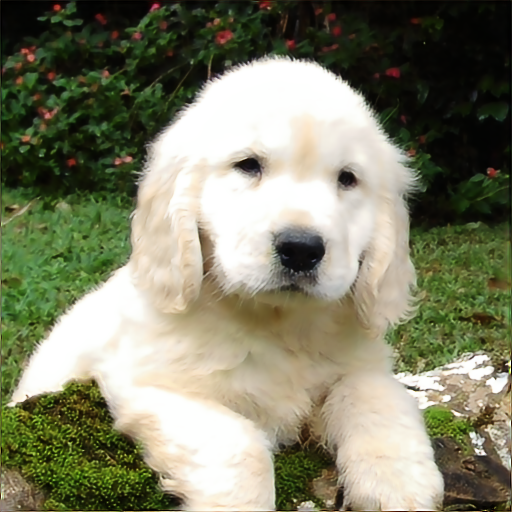
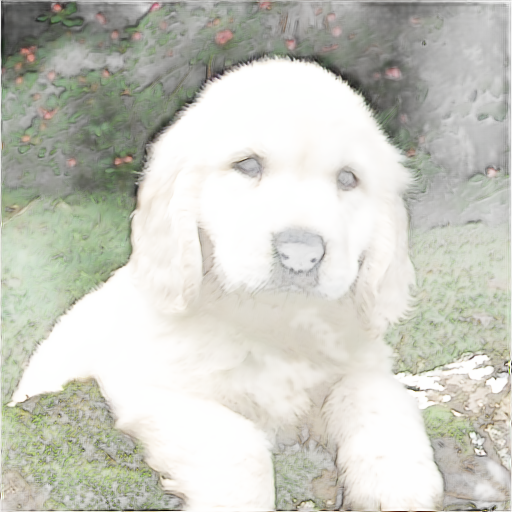
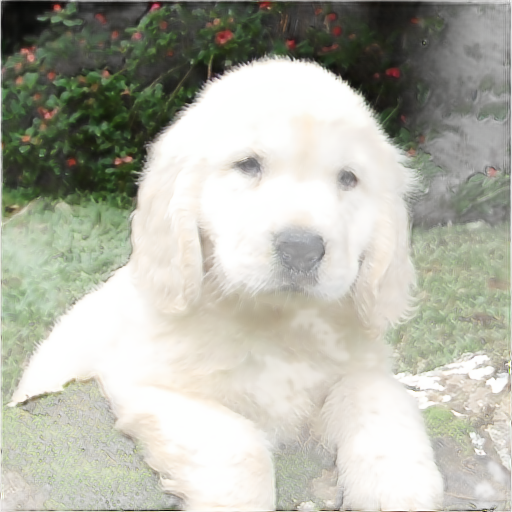
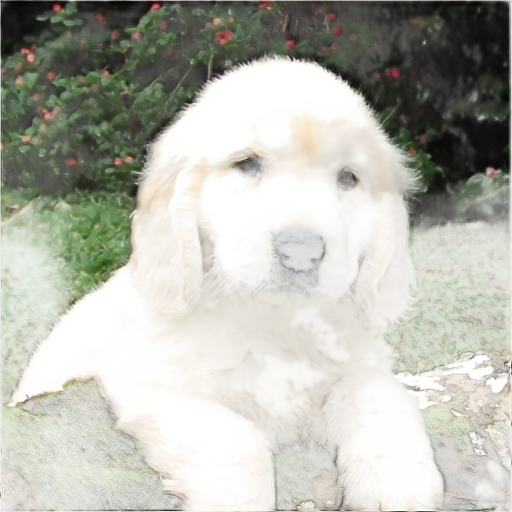
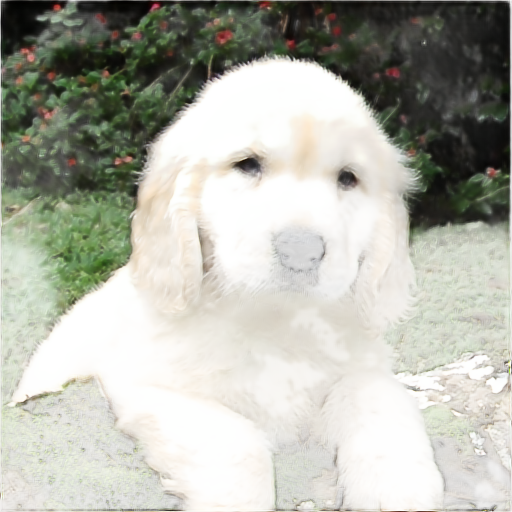
...
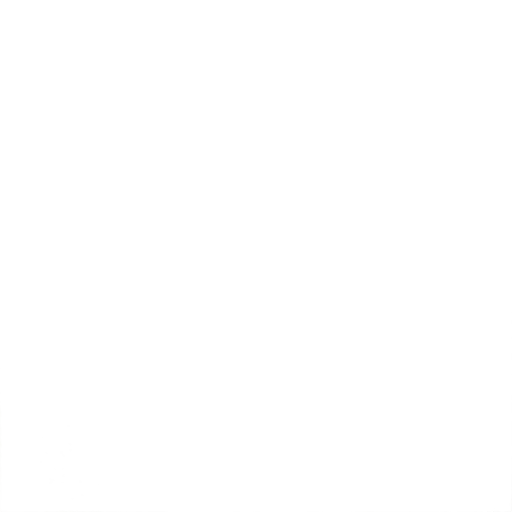
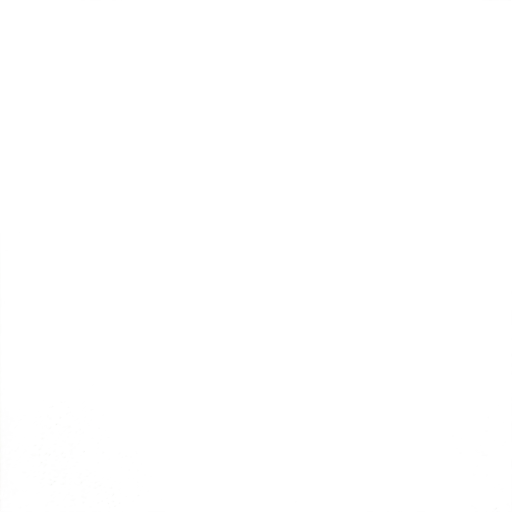
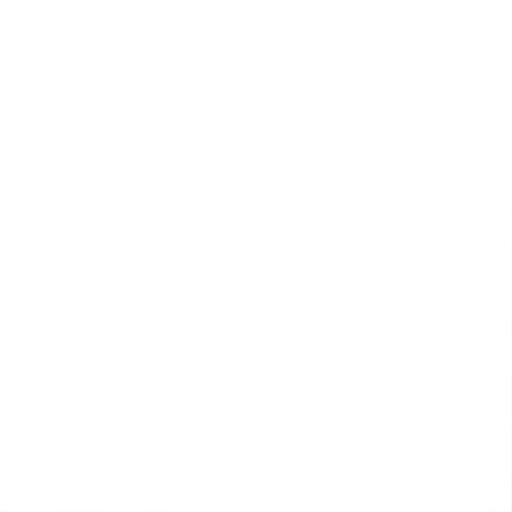
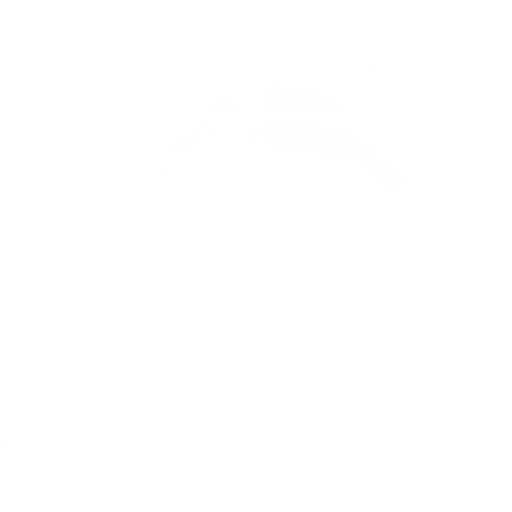
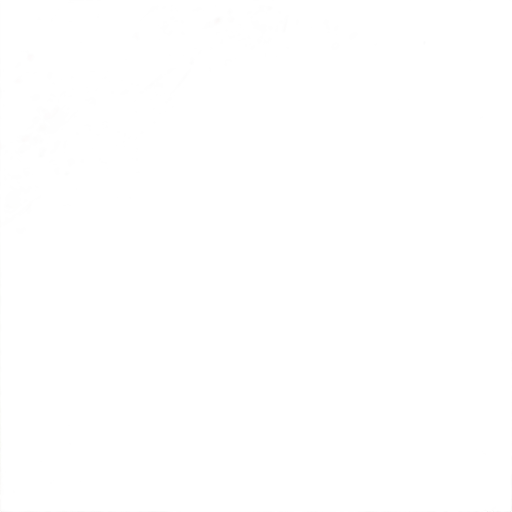

In [58]:
from IPython.display import display, HTML

display(HTML(html_viewer(layers, depths)))